# Mastering Data Visualization With Plotly Express
## TODO
![](images/unsplash.jpg)
<figcaption style="text-align: center;">
    <strong>
        Photo by 
        <a href='https://unsplash.com/@sushioutlaw?utm_source=unsplash&utm_medium=referral&utm_content=creditCopyText'>Brian McGowan</a>
        on 
        <a href='https://unsplash.com/s/photos/express?utm_source=unsplash&utm_medium=referral&utm_content=creditCopyText'>Pexels</a>
    </strong>
</figcaption>

### Setup

In [96]:
import warnings

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import seaborn as sns

pd.set_option("plotting.backend", "plotly")

warnings.filterwarnings("ignore")

config = {"staticPlot": True}

### Introduction

For the past few years, there has been an explosion of interest towards interactive plots. People were bored out of their minds from the old, static plots they have been using since before they were born. This was understandable because unlike other aspects of data science which rapidly change, there had not been much advancements in terms of data visualization. Matplotlib, Seaborn and ggplot have been dominating the game and many people wanted a change.

Then, Plotly came.

In 2015, a widely-accepted Plotly.js data visualization framework was open-sourced for both Python and R, making Plotly the most downloaded graphing library in the world that year. Like any other baby project, it had its flaws but it still became widely popular.

In 2019, version 4.0.0 of Plotly introduced the Plotly Express API that completely fueled the whole interactive plotting hype. Now, Plotly has more than 100 million downloads and has its APIs in Python, R, Julia, .NET and JS.

Considering its popularity and its usefulness, I wrote this article to give a solid introduction to Plotly's Express Python API for beginners. Enjoy!

### Plotly Figures

Plotly can be installed just like any other Python package:

```python
pip install plotly==5.1.0       # latest version with pip

conda install -c plotly plotly=5.1.0  # latest version with conda
```

After installation, Plotly Express can be imported under the standard alias `px`:

In [97]:
import plotly.express as px

The core data structure in Plotly is the `Figure` object. It is what it says in the name - it is the object that contains the plot(s) itself.

A single Figure object has minimum 2 components:

- `layout`: a dictionary controlling the style of the figure. Only one `layout` per figure
- `data`: list of dictionaries setting the graph type with `type`, `x`, `y` keywords. A group of data and a single graph type is called a `trace` in Plotly. There are more than 40 types.
- optional `frame`: a component for animated plots (will not be discussed today)

So, without further ado, let's take a look at your first Plotly figure:

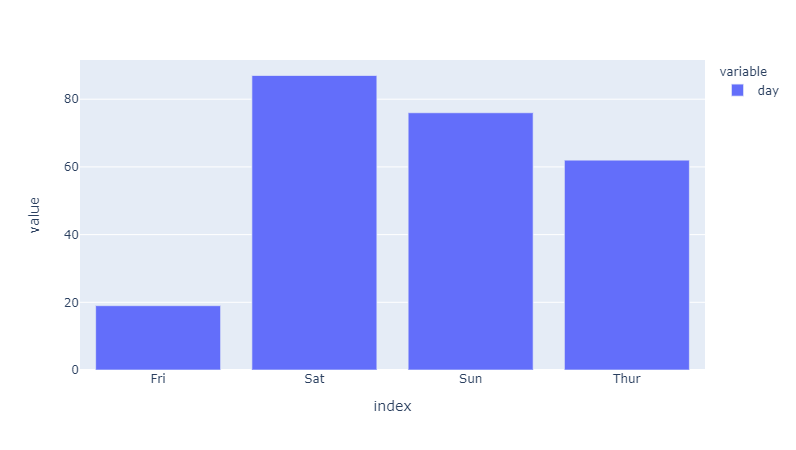

In [98]:
penguins = sns.load_dataset("penguins")
diamonds = sns.load_dataset("diamonds")
tips = px.data.tips()

fig = tips.groupby("day")["day"].count().plot.bar()
fig.show(config=config)

The above plot is the number of recorded sales in a restaurant grouped by the day of the week. Without looking at the code, let's look at the `Figure` object that created this plot:

```python
>>> print(fig)

Figure({
    'data': [{'type': 'bar',
              'x': array(['Fri', 'Sat', 'Sun', 'Thur'], dtype=object),
              'y': array([19, 87, 76, 62], dtype=int64),
              'yaxis': 'y'}],
    'layout': {'legend': {'title': {'text': 'variable'}},
               'template': '...',
               'xaxis': {'title': {'text': 'index'}},
               'yaxis': {'title': {'text': 'value'}}}
})
```



The object is basically a large dictionary. In the above output, I cleaned up a bit to show the most important aspects of this dictionary. Notably, the `data` key contains the type of the graph ('bar'), the values on the XAxis as unique values and the height of each bar as YAxis.

The second is the layout. Right now, it contains 4 key-value pairs. First is the legend and its properties. As you can see, more information about each component is given as a dictionary as well. The second argument (`template`) refers to the global theme used. It is empty because the default theme was used. The rest describes aspects of the axes. 

That's it - every Plotly graph will have the same structure, though albeit more complicated and larger.

![image.png](images/1.png)

Besides, all figures provide instant interactivity - hovering over an element or a bar in this case will show the species name and the height of the bar. We will see how to customize the hover labels later in the tutorial.

There are also other controls which can be see in the top right of each figure. Each controls different aspects of interactivity:

![](images/2.png)

Now that we are familiar with the basics, let's start creating plots!

### Distribution and Relationship Plots

Most common plots involve looking at the distribution of a column or a relationship between two or more features. Plotly Express has a universally same API for accessing and creating plots. Write the plot name as specified in the documentation after `px` and pass the relevant arguments. Let's see how to create a histogram of the diamond prices:

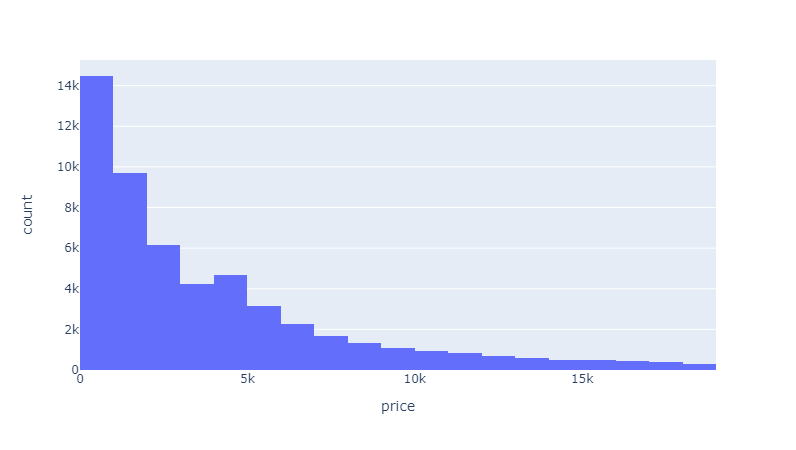

In [99]:
import seaborn as sns

diamonds = sns.load_dataset("diamonds")

fig = px.histogram(data_frame=diamonds, x="price", nbins=20)
fig.show(config=config)

Every plot call returns a `plotly.graph_objs` Figure object which should be stored in a variable and call the method `show()` to render the plot. Storing the figure in a variable is not required but as you will see, almost all plot customizations happen using the figure object making this step necessary.

Now, let's see how to create a countplot. This plot is not directly supported, so we will need to do the counting manually:

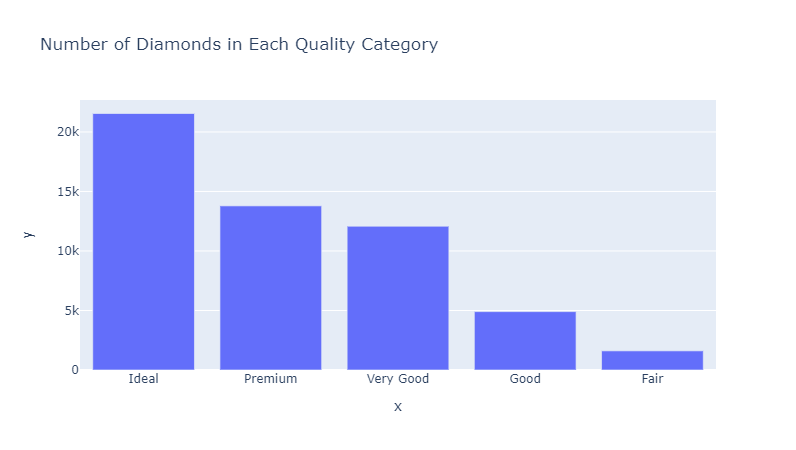

In [100]:
counts = diamonds.groupby("cut")["cut"].count()

fig = px.bar(
    x=counts.index, y=counts, title="Number of Diamonds in Each Quality Category"
)
fig.show(config=config)

Now, let's create a [boxplot](https://plotly.github.io/plotly.py-docs/generated/plotly.express.box.html) - another common plot type in data science:

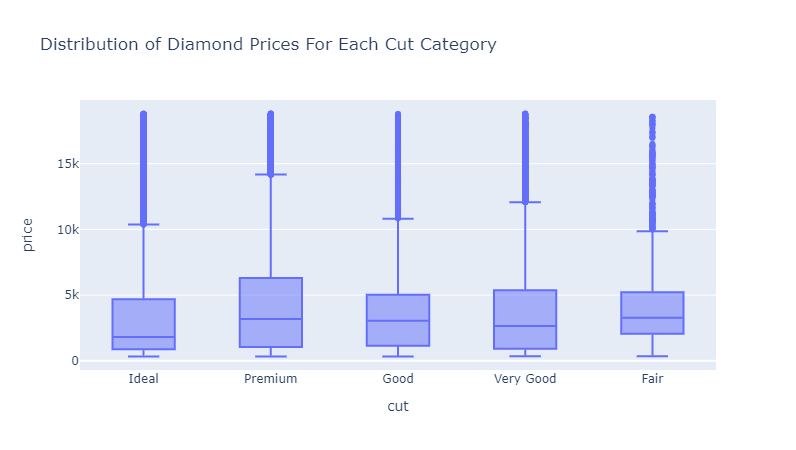

In [101]:
fig = px.box(
    data_frame=diamonds,
    x="cut",
    y="price",
    title="Distribution of Diamond Prices For Each Cut Category",
)

fig.show(config=config)

Awesome! There are other distribution plots such as [violin](https://plotly.com/python/violin/), [strip](https://plotly.com/python/strip-charts/), [density_heatmap](https://plotly.com/python/2D-Histogram/) and [density_contour](https://plotly.com/python/2d-histogram-contour/) (documenations are hyperlinked).

Now, let's look at relationship plots, starting with [scatterplots](https://plotly.com/python-api-reference/generated/plotly.express.scatter):

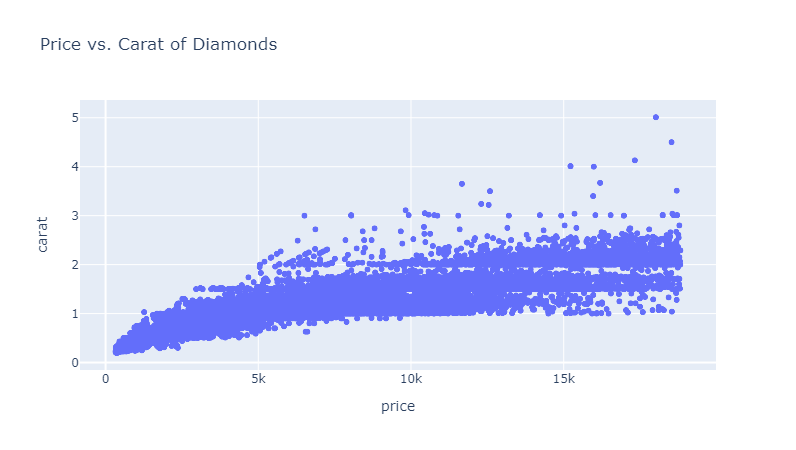

In [102]:
fig = px.scatter(diamonds, x="price", y="carat", title="Price vs. Carat of Diamonds")
fig.show(config=config)

As there are more than 50k diamonds in the dataset, the dots are pretty jammed and there is a non-linear relationship between price and carat. To fix this, you can use logarithmic axes, enabled by setting `log_x` or `log_y` to True:

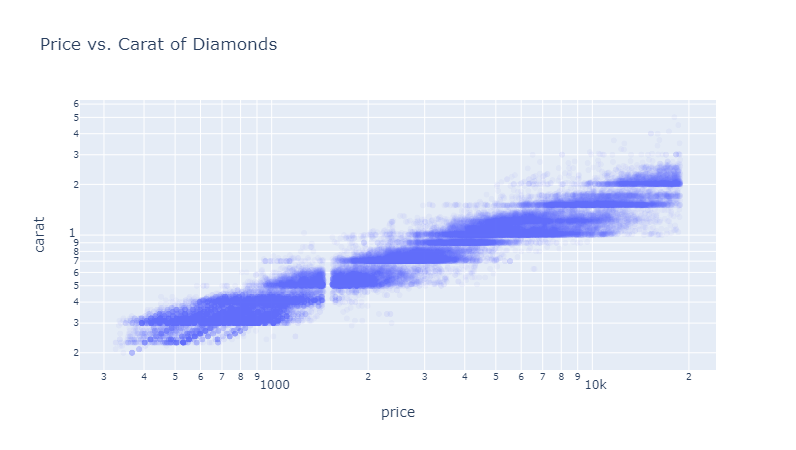

In [103]:
fig = px.scatter(
    diamonds,
    x="price",
    y="carat",
    title="Price vs. Carat of Diamonds",
    log_x=True,
    log_y=True,
    opacity=0.05,
)

fig.show(config=config)

> If you don't know about logarithmic scales, you can check out this article:

https://towardsdev.com/logarithmic-scale-how-to-plot-and-actually-understand-it-c38f00212206?source=your_stories_page-------------------------------------

Using logarithmic scales and more opaque dots (controlled with `opacity`) we can see some distinguished rows. This suggests that carats of some of the diamonds were rounded off at some thresholds.

It is also common to add a third variable to plots to encode as color. All plots that support this feature have `color` argument. You can pass another column name from the passed DataFrame to use it as color encoder. Plotly is smart enough to use discrete colors when passed column is categorical and continuous palette if otherwise:

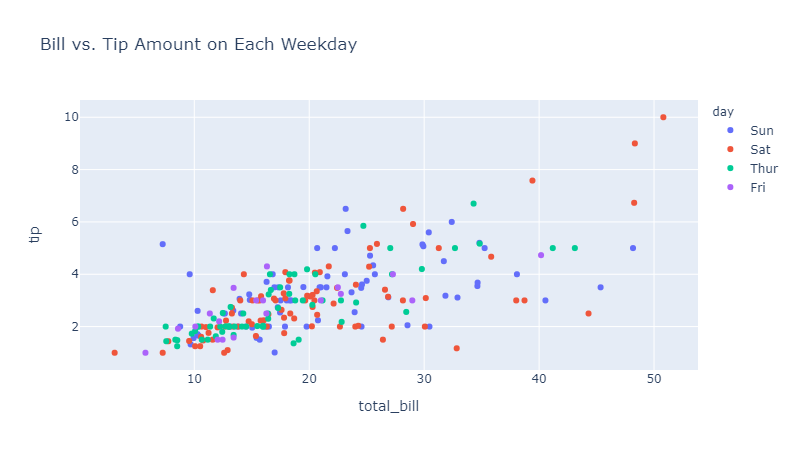

In [104]:
# Load the default tips dataset from plotly
tips = px.data.tips()

fig = px.scatter(
    tips,
    x="total_bill",
    y="tip",
    color="day",
    title="Bill vs. Tip Amount on Each Weekday",
)

fig.show(config=config)

Here is an example passing a numeric feature:

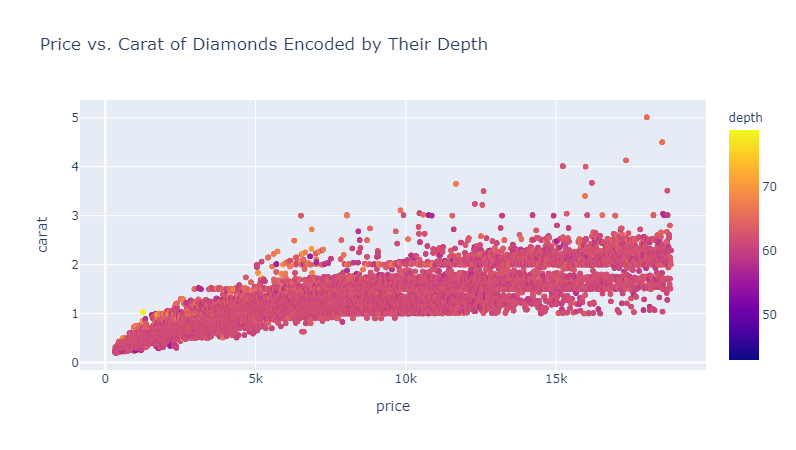

In [105]:
fig = px.scatter(
    diamonds,
    x="price",
    y="carat",
    color="depth",
    title="Price vs. Carat of Diamonds Encoded by Their Depth",
)

fig.show(config=config)

It is also possible to control the size of the dots based on another numeric column in the passed DataFrame:

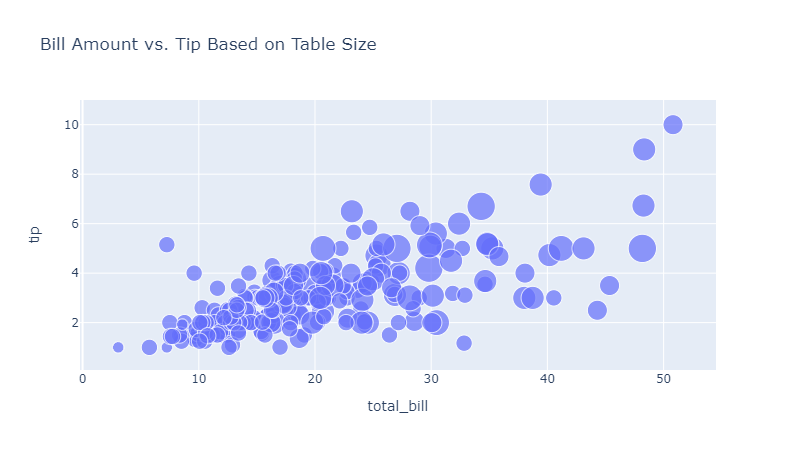

In [106]:
fig = px.scatter(
    tips,
    x="total_bill",
    y="tip",
    size="size",
    title="Bill Amount vs. Tip Based on Table Size",
)

fig.show(config=config)

The key takeaway from this section is that creating all plots have similar API calls and parameters. Checking out the documentation will tell you everything you need to know!

### Customizing labels, texts and axes

First, let's how we can customize the hover information. Each Plotly graph has `hover_data` and `hover_name` arguments. Setting the `hover_name` to another column name in the DataFrame shows the corresponding value in the data for the point under the mouse. 

You can also pass other column names to `hover_data` to display more information about each data point. Let's see an example:

```python
fig = px.scatter(
    diamonds,
    x="price",
    y="carat",
    color='cut',
    hover_name='cut',
    hover_data=['color', 'depth', 'table']
)

fig.show()
```

![](images/3.png)

Now, when we hover over each data point on the scatterplot, we get much more information. Note that the key names in the hover box appear exactly the same as they are written in the DataFrame itself. 

Plotly offers a variety of ways doing the same operation. For example, you can customize the hover information using the `update_layout` method of the Figure object. `update_layout` is a powerful that is used to customize almost any aspect of the plot. Let's further customize the hover box:

```python
fig = px.scatter(
    diamonds,
    x="price",
    y="carat",
    color="cut",
    hover_name="cut",
    hover_data=["color", "depth", "table"],
)

fig.update_layout(
    hoverlabel=dict(
        bgcolor="white", bordercolor="black", font={"size": 15, "color": "red"}
    )
)

fig.show()
```

![](images/4.png)

There is also a global `font` keyword which accepts its own dictionary of settings. You can change the size, 
font family and color of all text globally:

```python
fig.update_layout(
    font=dict(size=20, color='red', family='Arial')
)
```

Next, there are two other important parameters - `xaxis` and `yaxis`:

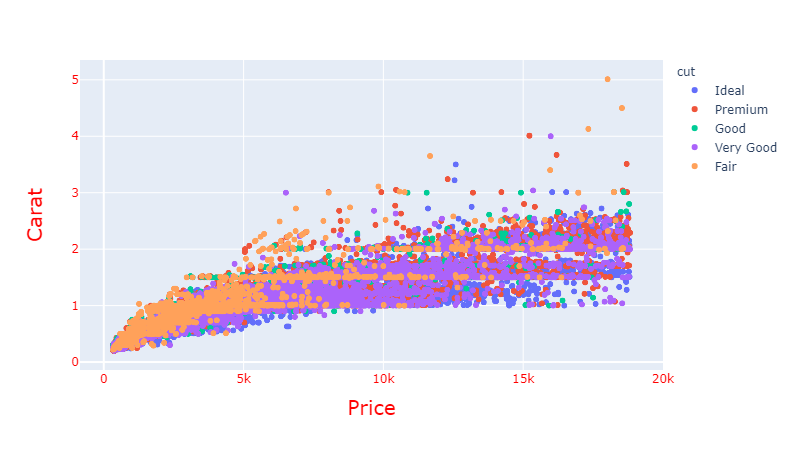

In [107]:
fig = px.scatter(
    diamonds,
    x="price",
    y="carat",
    color="cut",
    hover_name="cut",
    hover_data=["color", "depth", "table"],
)

fig.update_layout(
    xaxis=dict(color="red", title=dict(text="Price", font={"size": 20})),
    yaxis=dict(color="red", title=dict(text="Carat", font={"size": 20})),
)

fig.show(config=config)

You can update the title, legend, pretty much every aspect of the global figure using the relevant arguments and nested dictionaries. To see the full list of things you can customize, check out the [documentation](https://plotly.com/python/reference/layout/) of the `update_layout`.

### Colors

Just like any other library, you can change the colors using discrete color names like 'white', 'black', 'green', etc.

However, you will get a finer control over colors using RGB color system. First, let's see changing the color in-plot, i.e., directly inside the plot:

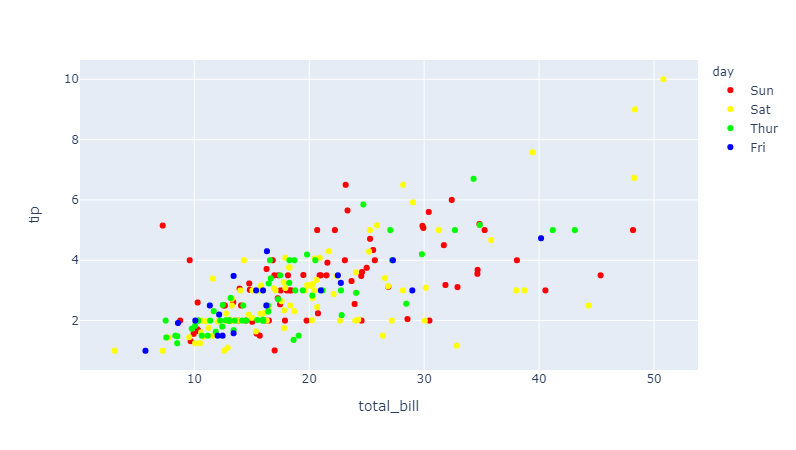

In [108]:
color_map = {
    "Sat": "rgb(255,255,0)",  # yellow
    "Sun": "rgb(255,0,0)",  # red
    "Thur": "rgb(0,255,0)",  # green
    "Fri": "rgb(0,0,255)",  # blue
}

fig = px.scatter(
    tips, x="total_bill", y="tip", color="day", color_discrete_map=color_map
)

fig.show(config=config)

When setting RGB colors, you have to use `rgb()` syntax as a string. 

Mapping individual colors to each category can become cumbersome. Fortunately, Plotly offers discrete color sequences under `px.color` module:

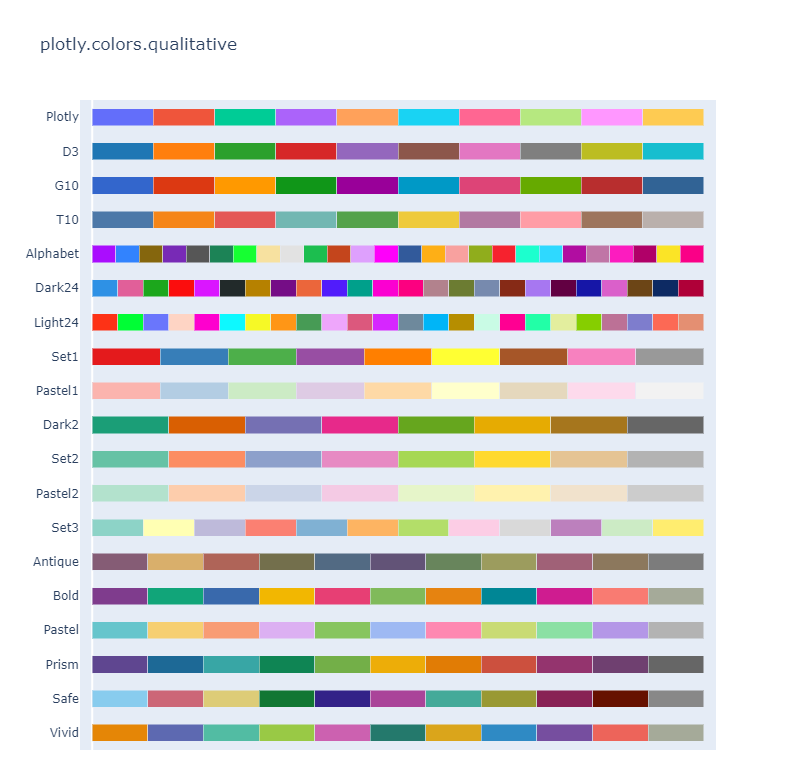

In [109]:
fig = px.colors.qualitative.swatches()

fig.show(config=config)

I like the Bold, so let's pass it to our scatterplot:

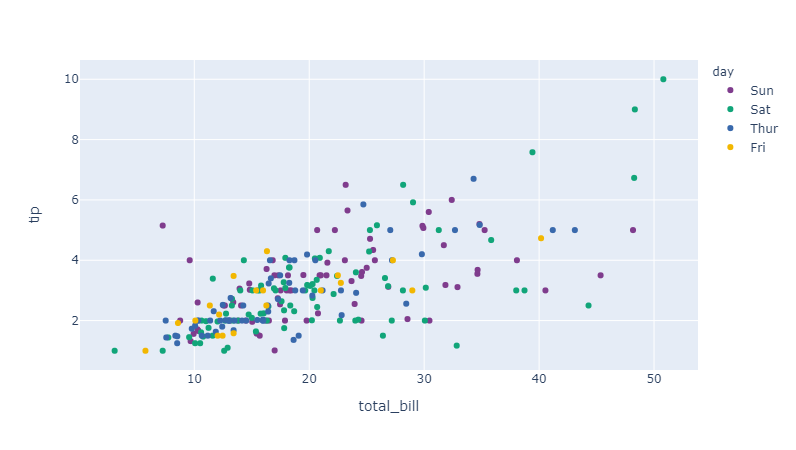

In [110]:
fig = px.scatter(
    tips,
    x="total_bill",
    y="tip",
    color="day",
    color_discrete_sequence=px.colors.qualitative.Bold,
)

fig.show(config=config)

If you are passing sequences, use `color_discrete_sequence` parameter. 

As you can pass numeric features to color, you may want to use a continuous color scale. The procedure for that is quite similar:

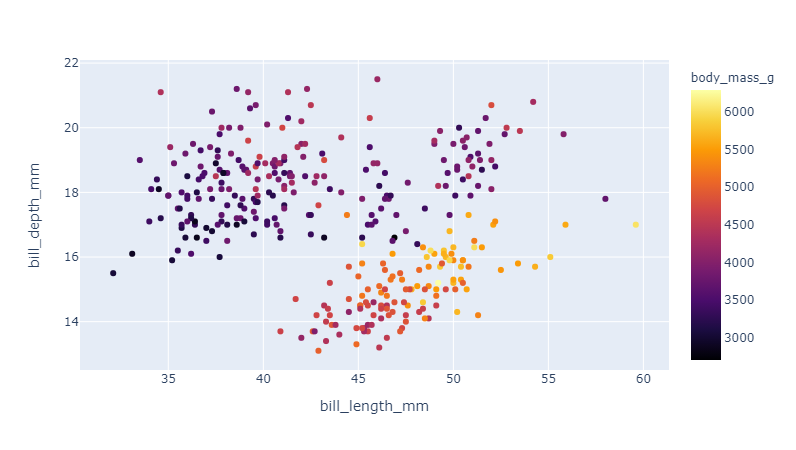

In [111]:
penguins = sns.load_dataset("penguins")

fig = px.scatter(
    penguins,
    x="bill_length_mm",
    y="bill_depth_mm",
    color="body_mass_g",
    color_continuous_scale=px.colors.sequential.Inferno,
)

fig.show(config=config)

### Annotations

A vital part of professional-looking plots are annotations. They are useful to draw the attention of the audience to specific parts of the plot or add information that is currently not visible. 

Adding annotations can be done using two ways:
1. Using `add_annotation` on the figure - adds a single annotation
2. Using `update_layout`: useful to add many annotations as a list simultaneously

For consistency, we will stick with `update_layout`.

Using the Penguins dataset, let's annotate two points on the above scatterplot. For simplicity, I will choose the points based on the graph:

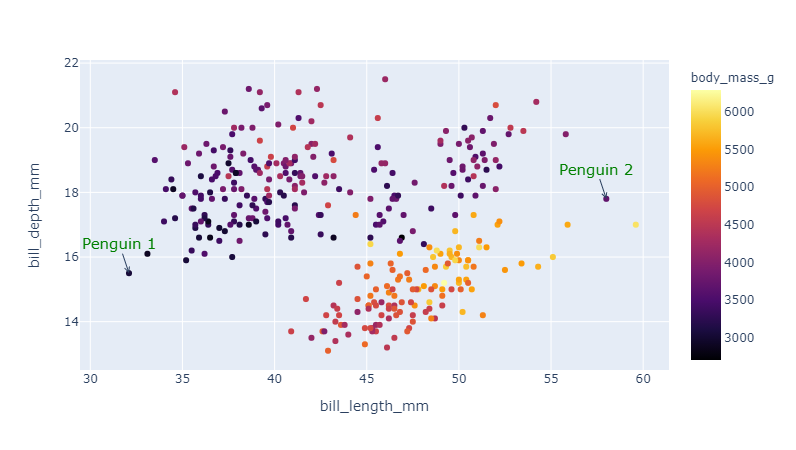

In [112]:
first_annotation = {
    "x": 32.1,
    "y": 15.5,
    "showarrow": True,
    "arrowhead": 5,
    "text": "Penguin 1",
    "font": {"size": 15, "color": "green"},
}

second_annotation = {
    "x": 58,
    "y": 17.8,
    "showarrow": True,
    "arrowhead": 5,
    "text": "Penguin 2",
    "font": {"size": 15, "color": "green"},
}

fig.update_layout({"annotations": [first_annotation, second_annotation]})

fig.show(config=config)

We first create two dictionaries that hold the features of the annotation. Each dictionary should contain `x` and `y` coordinate, actual text. Optionally, you can enable arrows, which are always useful. 

The passed coordinates to `x` and `y` should be data points recorded in the plot. Otherwise, the annotations will not display properly.

There is another way of positioning the text using absolute coordinates. The text will not dependent on the data points on the graph but will be placed along the percentages of the axes. For example, let's add a dummy text to the scatterplot right in the middle:

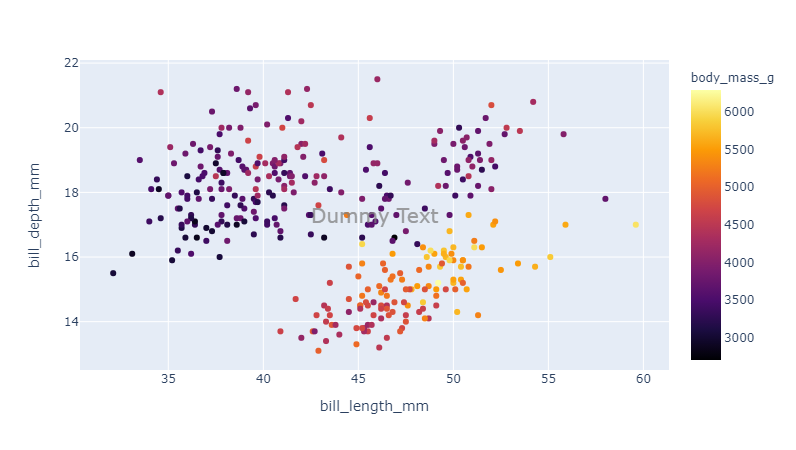

In [113]:
dummy_annotation = {
    "text": "Dummy Text",
    "opacity": 0.5,
    "align": "center",
    "x": 0.5,
    "y": 0.5,
    "xref": "paper",
    "yref": "paper",
    "font": {"size": 20, "color": "grey"},
    "showarrow": False,
}

fig.update_layout({"annotations": [dummy_annotation]})

fig.show(config=config)

To use absolute positioning, just set `xref` and `yref` keys to `paper`. The disadvantage of this coordinate system is that it does not change as your plot changes. Other data points might end up overlapping later. 

### Summary

By now, I hope you have realized how powerful Plotly can be. Besides, we have barely scratched the surface with its lightweight API. Even though there is a steeper learning curve, there is Graph Objects (`plotly.graph_objects)` API that gives enormous amount of customizations and additional features. I recommend checking out the [documentation](). Thanks for reading!